# Useful python for visualising neutron data in jupyter

# SCIPP 
### Data framework for neutron TOF data

In [1]:
import scipp as sc
import mantid.simpleapi as manty
import plotly.graph_objs as go
import numpy as np

/home/jon/.conda/envs/Mantid-2/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



In [2]:
from scipp import Dim


In [3]:
d = sc.Dataset(
   ....:         {'a': sc.Variable(dims=[Dim.X, Dim.Y], values=np.random.rand(1000, 1000)),
   ....:          'b': sc.Variable(1.0)},
   ....:          coords={
   ....:              Dim.X: sc.Variable([Dim.X], values=np.arange(1000.0), unit=sc.units.m),
   ....:              Dim.Y: sc.Variable([Dim.Y], values=np.arange(1000.0), unit=sc.units.us)},
   ....:          labels={
   ....:              'aux': sc.Variable([Dim.Y], values=np.random.rand(1000))})

In [4]:
print(d)
sc.plot(d)

<scipp.Dataset>
Dimensions: {{Dim.Y, 1000}, {Dim.X, 1000}}
Coordinates:
    Dim.X                     double    [m]              (Dim.X)
    Dim.Y                     double    [μs]            (Dim.Y)
Labels:
    aux                       double    [dimensionless]  (Dim.Y)
Data:
    a                         double    [dimensionless]  (Dim.X, Dim.Y)
    b                         double    [dimensionless]  ()
Attributes:




FigureWidget({
    'data': [{'colorbar': {'title': {'side': 'right', 'text': 'a'}},
              'colorscale'…

## Load a ISIS datafile as a mantid workspace object.

- Use dir as way to list all the available method that object 'out' has

In [5]:

data = manty.Load('../Data/MAR19717.raw')



In [8]:
from mantid.simpleapi import *
def workspace2dToDataSet(workspace):
    signal = mtd[workspace].extractY()
    error  = mtd[workspace].extractE()
    TOF    = mtd[workspace].extractX()[0]
    wkspDim=signal.shape

    TOFAxis=(TOF[0:wkspDim[1]])
    d = sc.Dataset(
        {'data': sc.Variable(dims=[Dim.X, Dim.Y], values=signal),
        },
        coords={
        Dim.X: sc.Variable([Dim.X], values=np.arange(signal.shape[0]), unit=sc.units.m),
        Dim.Y: sc.Variable([Dim.Y], values=TOFAxis, unit=sc.units.us)},
        )
    print(d)
    return d



In [9]:
d = workspace2dToDataSet('data')

<scipp.Dataset>
Dimensions: {{Dim.Y, 1900}, {Dim.X, 922}}
Coordinates:
    Dim.X                     int64     [m]              (Dim.X)
    Dim.Y                     double    [μs]            (Dim.Y)
Labels:
Data:
    data                      double    [dimensionless]  (Dim.X, Dim.Y)
Attributes:




In [10]:
sc.plot(d)

FigureWidget({
    'data': [{'colorbar': {'title': {'side': 'right', 'text': 'data'}},
              'colorsca…

# Making a simple UI to views the help documentation for the 2000 methods in the Mantid api

1. Import ipywidgets 
2. Import mantid simple api


In [4]:
import ipywidgets as ipw
mantidList=(dir(manty))
from mantid.simpleapi import *

algorithum_list = ipw.Dropdown(
    options = mantidList,
    description='Mantid Simple API algorithums',
    disabled=False,
)


helpButton=ipw.Button(value=False,
    description='MantidHelp',
    disabled=False,
    button_style='info', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='Description',
    icon='?')

display(algorithum_list)
display(helpButton)

out = ipw.Output(layout={'border': '1px solid black'})
display(out)

@out.capture()
def on_button_clicked(b):
    help(globals()[algorithum_list.get_interact_value()])

    
helpButton.on_click(on_button_clicked)



Dropdown(description='Mantid Simple API algorithums', options=('Abins', 'AbinsDialog', 'AbortRemoteJob', 'Abor…

Button(button_style='info', description='MantidHelp', icon='?', style=ButtonStyle(), tooltip='Description')

Output(layout=Layout(border='1px solid black'))

## Import some helper scripts that can be used to reduce (treat) TOF neutron data from the MARI instrument 

- qtigenie is a sript that has the iliad function that will convert neutron TOF data to energy transfer data

- This converts the units of Time of Flight in micro seconds to Energy Transfer in meV 

In [5]:
import sys


sys.path.append('../Scripts/qtiGenie/')
sys.path.append('../Scripts/MARI/')
sys.path.append('../Scripts/MARI/MapFiles/')


pathToData='/home/jon/Raciri-2019/Data/'

pathToMapFile='/home/jon/Raciri-2019/Scripts/MARI/MapFiles/'

from qtiGenie import iliad
import ipywidgets as widgets

Using qtiplot graphics
You can change it by issuing setinst(InstrumentName) command
where InstrumentName can be MER, MAR, MAP, LET, TSK or XSD


In [6]:
from Direct.DirectEnergyConversion import *
import Direct.dgreduce as dgreduce

iliad_setup=dgreduce.setup
iliad=dgreduce.arb_units
iliad_abs=dgreduce.abs_units
    
iliad_reducer = dgreduce.getReducer

#@out.capture()
def reduceSimple(runNumber):
    inst='mar'
    iliad_setup(inst)
    ext='.raw'
    #mapfile='mari_res2013'
    mapfile=pathToMapFile+'mari_121_cor'

    #det_cal_file must be specified if the reduction sends out put to a workpsace
    cal_file=pathToData+'MAR19717.raw'
    #hard mask file
    #mask_file='/home/mari/Users/taylor/mask.msk'
    #load vanadium file
    whitebeamfile=pathToData+'MAR19717.raw'
    LoadRaw(Filename=whitebeamfile,OutputWorkspace="wb_wksp",LoadLogFiles="0")

    runs=pathToData+'MAR'+str(runNumber)+'.raw'; ei=12; rebin_params='-10,.05,11'; sum=False
    LoadRaw(Filename=runs,OutputWorkspace="run_wksp",LoadLogFiles="0")
    w1=iliad("wb_wksp","run_wksp",ei,rebin_params,mapfile,fixei=False,det_cal_file=cal_file,norm_method='current')

We could call reduce simple in a cell 
Instead we can make a small UI to run it for us using a widget and sending the output to a text widget with @capture

In [7]:
button1 = widgets.Button(description="Reduce Data")
display(button1)

button2 = widgets.Button(description="Clear")
display(button2)

text_field=widgets.Text(value='run number')
display(text_field)

TextOutput = widgets.Output(layout={'border': '1px solid black'})
display(TextOutput)

@TextOutput.capture()
def on_button_clicked(b):
    runNumber = text_field.value
    print ('Running Iliad on file ',runNumber)
    reduceSimple(runNumber)
    ei = mtd['w1'].getRun().getLogData("Ei").value
    print('Incident Neutron Energy for run', runNumber,' determined as ',ei,'meV')

@TextOutput.capture()
def on_clear_clicked(b):
    TextOutput.clear_output()
  
    

button1.on_click(on_button_clicked)
button2.on_click(on_clear_clicked)

Button(description='Reduce Data', style=ButtonStyle())

Button(description='Clear', style=ButtonStyle())

Text(value='run number')

Output(layout=Layout(border='1px solid black'))

The mantid workspace has all the instrument & run meta data
- We will get the calculated incident energy from the workspace object

In [16]:
incident_energy=mtd['w1'].getRun().getLogData("Ei").value
print (incident_energy,'meV')



12.045315866660905 meV


## We will make a UI to list and plot all the mantid workspaces that exisit in the kernal session

In [17]:
%matplotlib inline
import matplotlib.pyplot as plt


mtd.importAll()
workSpaceList = %who_ls Workspace2D
workSpaceListWidget = widgets.Dropdown(
    options=workSpaceList,
    description='WorkSpace:',
    disabled=False,
)

buttonSelectWorkspace = widgets.Button(description="Select Workspace",layout=widgets.Layout(width='auto', grid_area='main'))
#display(buttonPlotSpectrum)

buttonPlotSpectrum = widgets.Button(description="plot spectrum",layout=widgets.Layout(width='auto', grid_area='main'))
#display(buttonPlotSpectrum)

buttonPlot2D = widgets.Button(description="plot 2D",layout=widgets.Layout(width='auto', grid_area='main'))
#display(buttonPlot2D)

clearPlots = widgets.Button(description="ClearPlots",layout=widgets.Layout(width='auto', grid_area='main'))
#display(buttonPlot2D)

text_field_spec = widgets.Text(value='Spectrum_number')

PlotOutput = widgets.Output(layout={'border': '1px solid black'})

TextOutput = widgets.Output(layout={'border': '1px solid black'})


list_widgets  = [
    widgets.VBox([workSpaceListWidget,buttonSelectWorkspace,TextOutput]),
    widgets.VBox([buttonPlotSpectrum,text_field_spec]),
    buttonPlot2D, widgets.VBox([clearPlots, PlotOutput])]

accordion = widgets.Accordion(children=list_widgets)
accordion.set_title(0, 'Select Data')
accordion.set_title(1, '1D Plot')
accordion.set_title(2, '2D Plot')
accordion.set_title(3, 'Plot Output')
display(accordion)

@PlotOutput.capture()
def on_plotSpectrum_button_clicked(a):
    specNumber = int(text_field_spec.value)
    print (type (specNumber),specNumber)
    selectedWorkspace = workSpaceListWidget.value
    dataY = mtd[selectedWorkspace].extractY()
    plt.figure()
    plt.plot(dataY[specNumber,:])
    plt.show()

    
@PlotOutput.capture()
def on_plot2D_button_clicked(b):
    
    selectedWorkspace = workSpaceListWidget.value
    dataY = mtd[selectedWorkspace].extractY()
    plt.figure()
    plt.imshow(dataY,vmin=0,vmax=10,aspect='auto')
    plt.show() 
    
@PlotOutput.capture()
def on_clearPlots_button_clicked(c):
    plt.close('all')
    PlotOutput.clear_output()

@PlotOutput.capture()
def on_clear_clicked(d):
    out.clear_output()
  
@TextOutput.capture()
def on_buttonSelectWorkspace_button_clicked(e):
    selectedWorkspace = workSpaceListWidget.value
    dataY = mtd[selectedWorkspace].extractY()
    print (dataY.shape)
    return dataY,selectedWorkspace
 
   

buttonPlotSpectrum.on_click(on_plotSpectrum_button_clicked)
buttonPlot2D.on_click(on_plot2D_button_clicked)
clearPlots.on_click(on_clearPlots_button_clicked)


Accordion(children=(VBox(children=(Dropdown(description='WorkSpace:', options=('WB_MARwb_wksp019717_norm_white…

# Visualising neutron TOF data
## Holoviews is a very adaptable visualisation package
- It requires a defined data structure 
- Pandas ( for Tabular data)
- Xarray for gridded data

### What is useful about these types of packages is that the data structure is well defined with diminesion names to make subsequent operations more straighforwards

### There are limitations, xarray doesn't know about errors or anything that specific to neutron or photon data like scientific units or geometry. 


1. First load some data. 
2. Write a small function that converts the TOF and signal values from a mantid workspace to a holoviews dataset.


In [18]:
someData = manty.LoadRaw('/home/jon/Sandbox/Data/MAR20000.raw')

In [19]:

def mantidWkspToHoloViewDataSet(wkspname):
    import holoviews as hv
    signal = mtd[wkspname].extractY()
    error  = mtd[wkspname].extractE()
    TOF    = mtd[wkspname].extractX()
    wkspDim=signal.shape
    dataCopy=np.zeros([wkspDim[0],wkspDim[1],2])
    dataCopy[:,:,0]=signal
    dataCopy[:,:,1]=error
    ds = hv.Dataset((np.arange(wkspDim[1]),np.arange(wkspDim[0]),dataCopy[:,:,0]),['x', 'y'], 'Counts')
    #ingore errors
    return ds

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
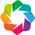

:Image   [x,y]   (Counts)

In [20]:
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')

hvDs = mantidWkspToHoloViewDataSet('w1')


points = hvDs.to(hv.Image)
points.opts(width=500, height=500)

### So when we plot the 2d data we dont know really anything about the axis. That has to be added by the user, or by using a different data structure 

### Also note that the color mapping of the z axis does not make it easy to visualise. At first glance it looks like a sparse data set. 
- This scaling issue of Z in 2D plots is common in visualistaion of scientific data. Most packages assume that the dynamic range of the data is low. When in this case (inelastic neutron scattering it is not)

- We can uses the functionality of holoviews to make a data explorer widget.

In [21]:
signal = someData.extractY()[0]
error  = someData.extractE()[0]
TOF    = someData.extractX()[0]

## Lets write a 'super plot' function.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
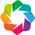

In [22]:
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')

opts.defaults(
    opts.GridSpace(shared_xaxis=True, shared_yaxis=True),
    opts.Image(cmap='jet', width=500, height=500),
    opts.Labels(text_color='white', text_font_size='8pt', text_align='left', text_baseline='bottom'),
    opts.Path(color='white'),
    opts.Spread(width=600),
    opts.Overlay(show_legend=False),
    )
def superplot1(wksp):
    hvDs = mantidWkspToHoloViewDataSet(wksp)
    img = hvDs.to(hv.Image).opts(colorbar=True, colorbar_position = 'left')

    posy = hv.streams.PointerY()
    hline = hv.DynamicMap(lambda y: hv.HLine(y or -100), streams=[posy])

    posx = hv.streams.PointerX()
    vline = hv.DynamicMap(lambda x: hv.VLine(x or -100), streams=[posx])


    crosssection2 = hv.DynamicMap(lambda y: img.sample(y=y if y else 0), streams=[posy])
    crosssection1 = hv.DynamicMap(lambda x: img.sample(x=x if x else 0), streams=[posx])

# Combine images, vline and cross-sections
#((img1 * hline * vline) << crosssection1)+((img1 * vline) << crosssection1)

    return ((img * hline * vline) << crosssection1 << crosssection2)

In [23]:
superplot1('w1')

:AdjointLayout
   :DynamicMap   []
      :Overlay
         .Image.I :Image   [x,y]   (Counts)
         .HLine.I :HLine   [x,y]
         .VLine.I :VLine   [x,y]
   :DynamicMap   []
      :Curve   [y]   (Counts)
   :DynamicMap   []
      :Curve   [x]   (Counts)

# The lowest value of the color map does not capture the fine detail in the plot.

## we could use a log fucntion, or we could play with the Z scale itself. This however actually sucks
- Everytime a plot is made the z axis must be evaluated
- In code thats rubbish. 

# There is another way - *Shade* the data


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
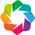


The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../lib/python3.6/site-packages/datashader/resampling.py", line 235:
@ngjit_parallel
def _get_dimensions(src, out):
^



:Layout
   .Image.I      :Image   [x,y]   (Counts)
   .DynamicMap.I :DynamicMap   []
      :RGB   [x,y]   (R,G,B,A)

In [24]:
import numpy as np
import holoviews as hv
from holoviews import opts
from holoviews import streams
from matplotlib import cm
hv.extension('bokeh')

from holoviews.operation.datashader import datashade

opts.defaults(
    opts.GridSpace(shared_xaxis=True, shared_yaxis=True),
    opts.Image(cmap='jet', width=700, height=700),
    opts.Labels(text_color='white', text_font_size='8pt', text_align='left', text_baseline='bottom'),
    opts.Path(color='white'),
    opts.Spread(width=600),
    opts.Overlay(show_legend=False),
    )


ds = mantidWkspToHoloViewDataSet('w1')



#datashade(ds)
points = ds.to(hv.Image).opts(width=300, height=300)
shaded = datashade(points,cmap=cm.viridis).opts(width=300, height=300)
points + shaded

#### The visual difference between the shaded and not shaded data is apparent

##### We will rewrite the super plot to use data shader with a linear colormap from Matplotlib

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
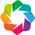

In [28]:
import numpy as np
import holoviews as hv
from holoviews import opts
from holoviews import streams

from holoviews.operation.datashader import datashade

from matplotlib import cm

hv.extension('bokeh')

opts.defaults(
    opts.GridSpace(shared_xaxis=True, shared_yaxis=True),
    opts.Image(cmap='jet', width=700, height=700),
    opts.Labels(text_color='white', text_font_size='8pt', text_align='left', text_baseline='bottom'),
    opts.Path(color='white'),
    opts.Spread(width=600),
    opts.Overlay(show_legend=False),
    )
opts.defaults(opts.Histogram(framewise=True))

#ds = hv.Dataset((np.arange(2624),np.arange(922),dataCopy[:,:,0]),['x', 'y'], 'Counts')
#ds.data

#def holoViewInteractive2D(hvDataSet):
    # Declare distribution of Points

def superplot2(wksp):    
    hvDs = mantidWkspToHoloViewDataSet(wksp)
    points = hvDs.to(hv.Image)
    points.opts(colorbar=True, colorbar_position = 'left')

    # Declare a Bounds stream and DynamicMap to get box_select geometry and draw it
    box = streams.BoundsXY(source=points, bounds=(0,0,0,0))
    bounds = hv.DynamicMap(lambda bounds: hv.Bounds(bounds), streams=[box])

    # Declare DynamicMap to apply bounds selection
    dmap = hv.DynamicMap(lambda bounds: points.select(x=(bounds[0], bounds[2]),y=(bounds[1], bounds[3])),streams=[box])

    # Compute histograms of selection along x-axis and y-axis
    yhist = hv.operation.histogram(dmap, bin_range=points.range('y'), dimension='y', num_bins = 500, weight_dimension='Counts', mean_weighted=True)
    xhist = hv.operation.histogram(dmap, bin_range=points.range('x'), dimension='x', num_bins = 500, weight_dimension='Counts', mean_weighted=True)


    #hv.Curve(selection.aggregate('Time', np.mean))

    #roi = ds.select(x=(bounds[0], bounds[2]),y=(bounds[1], bounds[3]), ).relabel('ROI')
    #region = roi.to(hv.Image, ['x', 'y'])

    # Combine components and display
    #points * mean_sel * bounds << yhist << xhist

    shaded = datashade(points,cmap=cm.viridis).opts(width=500, height=500)
    return (shaded * bounds) << yhist << xhist
    

#holoViewInteractive2D(hvDs)

In [33]:
superplot2('w1')

invalid value encountered in true_divide


:AdjointLayout
   :DynamicMap   []
      :Overlay
         .RGB.I    :RGB   [x,y]   (R,G,B,A)
         .Bounds.I :Bounds   [x,y]
   :DynamicMap   []
      :Histogram   [y]   (Counts)
   :DynamicMap   []
      :Histogram   [x]   (Counts)

##### Now that looks better without having to think of the z axis scale. 
##### Adding histograms rather than line plots allows better evaluation of the structre of the data

- Now we can convert the data from a grid to Momemtum Transfer (|Q|)

In [26]:
Qdata=SofQWNormalisedPolygon(InputWorkspace=w1,QAxisBinning='0,0.01,5',Emode='Direct',EFixed=12,ReplaceNaNs = True)

In [29]:
superplot2('Qdata')

invalid value encountered in true_divide


:AdjointLayout
   :DynamicMap   []
      :Overlay
         .RGB.I    :RGB   [x,y]   (R,G,B,A)
         .Bounds.I :Bounds   [x,y]
   :DynamicMap   []
      :Histogram   [y]   (Counts)
   :DynamicMap   []
      :Histogram   [x]   (Counts)

- Holowviews can be easily used to buld up complex publication quality plots 
- Having a note book environment allows all the data reduction and visualisation processing to be saved and documented
- in a variety of formats. 

## There are many python packages for data analysis and modelling. 
#### What is important is to be able to save the meta data for a model in a defined format 
- Interoperability between softwares is benificial

#### This is the motivation for the Atomic Simulation Environment (ASE) 
- A python Package that acts as a abstraction layer between simulation codes and python

- Lets use that to run a quick simulation of the Phonon modes in Aluminium. 

- For inelastic sccattering where ther signal is always small its a good idea to know what contributions can come from common materials found in the experiment like Aluminium 

In [25]:
from ase.build import bulk
from ase.calculators.emt import EMT
from ase.phonons import Phonons

# Setup crystal and EMT calculator
atoms = bulk('Al', 'fcc', a=4.05)

# Phonon calculator
N = 7
ph = Phonons(atoms, EMT(), supercell=(N, N, N), delta=0.05)
ph.run()

# Read forces and assemble the dynamical matrix
ph.read(acoustic=True)
ph.clean()

path = atoms.cell.bandpath('GXULGK', npoints=100)
bs = ph.get_band_structure(path)

dos = ph.get_dos(kpts=(20, 20, 20)).sample_grid(npts=100, width=1e-3)



Writing phonon.eq.pckl
Writing phonon.0x-.pckl
Writing phonon.0x+.pckl
Writing phonon.0y-.pckl
Writing phonon.0y+.pckl
Writing phonon.0z-.pckl
Writing phonon.0z+.pckl


Text(0.5, 0, 'DOS')

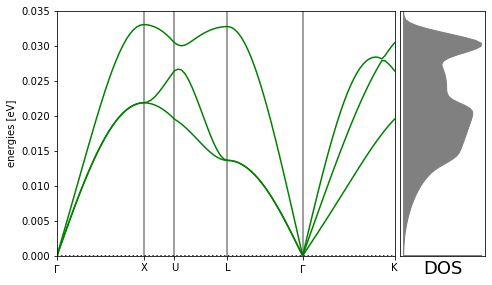

In [26]:
# Plot the band structure and DOS:
%matplotlib inline
import matplotlib.pyplot as plt


fig = plt.figure(1, figsize=(7, 4))
ax = fig.add_axes([.12, .07, .67, .85])

emax = 0.035
bs.plot(ax=ax, show=False, emin=0.0, emax=emax)
aa=bs.todict()
aa.keys
dosax = fig.add_axes([.8, .07, .17, .85])
dosax.fill_between(dos.weights[0], dos.energy, y2=0, color='grey',edgecolor='k', lw=1)

dosax.set_ylim(0, emax)
dosax.set_yticks([])
dosax.set_xticks([])
dosax.set_xlabel("DOS", fontsize=18)





In [27]:
from ase.visualize import view
view(atoms,viewer='ngl')

_ColormakerRegistry()

In [81]:
import bokeh
from bokeh.io import output_notebook, push_notebook
output_notebook()

##

import numpy as np
from ipywidgets import interact, widgets

from bokeh.plotting import figure, show
from bokeh.models import LogColorMapper, LogTicker, ColorBar, HoverTool
from bokeh.layouts import column
from bokeh.models.widgets import RangeSlider


def normal2d(X, Y, sigx=1.0, sigy=1.0, mux=0.0, muy=0.0):
    z = (X-mux)**2 / sigx**2 + (Y-muy)**2 / sigy**2
    return np.exp(-z/2) / (2 * np.pi * sigx * sigy)

X, Y = np.mgrid[-3:3:100j, -2:2:100j]
Z = normal2d(X, Y, 0.1, 0.2, 1.0, 1.0) + 0.1*normal2d(X, Y, 1.0, 1.0)
image = Z * 1e6

color_mapper = LogColorMapper(palette="Viridis256", low=1, high=1e7)
plot = figure(x_range=(0,1), y_range=(0,1), 
              tools=[HoverTool(tooltips=[("x", "$x"), ("y", "$y"), ("value", "@image")])],
             toolbar_location=None)
plot.image(image=[image], color_mapper=color_mapper,
           dh=[1.0], dw=[1.0], x=[0], y=[0])

color_bar = ColorBar(color_mapper=color_mapper, ticker=LogTicker(),
                     label_standoff=12, border_line_color=None, location=(0,0))

plot.add_layout(color_bar, 'right')
t = show(plot, notebook_handle=True)

def update(colours):
    color_mapper.low, color_mapper.high = colours
    push_notebook(color_mapper)

cols = widgets.FloatRangeSlider(min=1,max=1e7,value=[1, 1e7])
interact(update, colours=cols);

Loading BokehJS ...

interactive(children=(FloatRangeSlider(value=(1.0, 10000000.0), description='colours', max=10000000.0, min=1.0…

## Data Management from within jupyter

### We can connect our jupyter session to a data catalouge and then search the catalouge.

In [29]:
import requests
import json
import urllib

def search_scicat(text, max_number_results):
    fields = {'text': text}
    limit = {'limit': max_number_results, 'order': "creationTime:desc"}
    fields_encode = urllib.parse.quote(json.dumps(fields))
    limit_encode = urllib.parse.quote(json.dumps(limit))
    dataset_url = "https://scicatapi.esss.dk/api/v3/Datasets/anonymousquery?fields=" + \
                fields_encode+"&limits="+limit_encode
    r=requests.get(dataset_url).json()
    print(len(r), "result found!")
    return r

In [33]:
results=search_scicat("Al",100)

63 result found!


#### There are 63 results found with the keyword 'Al' the results data object contains all of the meta data locations for those results.

In [36]:
results

[{'owner': 'Clement Derrez',
  'ownerEmail': 'Clement.Derrez@esss.se',
  'contactEmail': 'Clement.Derrez@esss.se',
  'sourceFolder': '/users/detector/experiments/beamInstrumentation/FMC-PICO-evaluation',
  'size': 1792968,
  'packedSize': 1792968,
  'creationTime': '2019-03-29T10:02:27.000Z',
  'type': 'raw',
  'validationStatus': 'valid',
  'keywords': ['BeamInstrumentation', 'neutron', 'detector'],
  'description': 'This data was collected as part of the beam instrumentation program https://github.com/ess-dmsc/ess_file_formats/wiki/HDF5',
  'datasetName': 'Sample Data from BeamInstrumentation 3',
  'license': 'ESS',
  'version': '3.01',
  'isPublished': True,
  'ownerGroup': 'ess',
  'accessGroups': ['brightness', 'ess'],
  'updatedBy': 'ingestor',
  'updatedAt': '2019-04-30T11:51:21.959Z',
  'datasetlifecycle': {'archivable': True,
   'retrievable': False,
   'dateOfDiskPurging': '2029-03-29T09:02:27.966Z',
   'archiveRetentionTime': '2029-03-29T09:02:27.966Z',
   'dateOfPublishing'

##### The results list can be indexed for the file location (for example)

In [39]:

print(results[0]["sourceFolder"])

/users/detector/experiments/beamInstrumentation/FMC-PICO-evaluation
